# Sentinel-2 Image Matching Demo

Cross-season satellite image matching using SIFT and RANSAC.

## Setup

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import json
import pandas as pd

from algorithm import SIFTMatcher, load_image_pair

%matplotlib inline

In [2]:
PAIRS_DIR = './data/pairs'

matcher = SIFTMatcher(
    ratio_threshold=0.8,
    ransac_threshold=10.0,
    min_matches=4,
    nfeatures=10000
)

## Load Dataset

In [3]:
pairs_path = Path(PAIRS_DIR)
pair_dirs = sorted(pairs_path.glob('pair_*'))

pairs_info = []
for pair_dir in pair_dirs:
    with open(pair_dir / 'metadata.json') as f:
        metadata = json.load(f)
    pairs_info.append({
        'pair_id': metadata['pair_id'],
        'dir': pair_dir,
        'season1': metadata['img1'].get('season'),
        'season2': metadata['img2'].get('season')
    })

print(f"Found {len(pairs_info)} pairs")

Found 6 pairs


## Visualization Function

In [10]:
def visualize_matches(img1, img2, pts1, pts2):
    h1, w1 = img1.shape[:2]
    h = max(h1, img2.shape[0])
    canvas = np.zeros((h, w1 + img2.shape[1], 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:img2.shape[0], w1:] = img2
    
    fig, ax = plt.subplots(figsize=(18, 9), dpi=120)
    ax.imshow(canvas)
    
    for (x1, y1), (x2, y2) in zip(pts1, pts2):
        ax.plot([x1, x2 + w1], [y1, y2], color='#00FF00', lw=1.2, alpha=0.7)
        ax.plot(x1, y1, 'x', color='#00FF00', ms=8, mew=2)
        ax.plot(x2 + w1, y2, 'x', color='#00FF00', ms=8, mew=2)
    
    ax.axis('off')
    ax.set_title(f'{len(pts1)} matches', fontsize=14)
    plt.tight_layout()
    plt.show()

## Visualize All Pairs


Pair 1: winter vs summer
Keypoints: 6511, 6120
Matches: 59 raw, 27 inliers


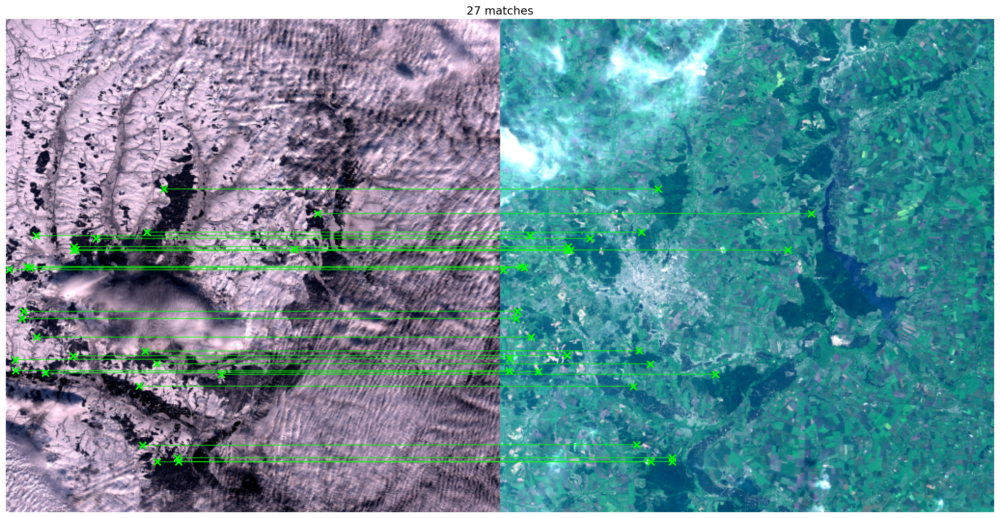


Pair 2: winter vs spring
Keypoints: 6511, 6514
Matches: 65 raw, 28 inliers


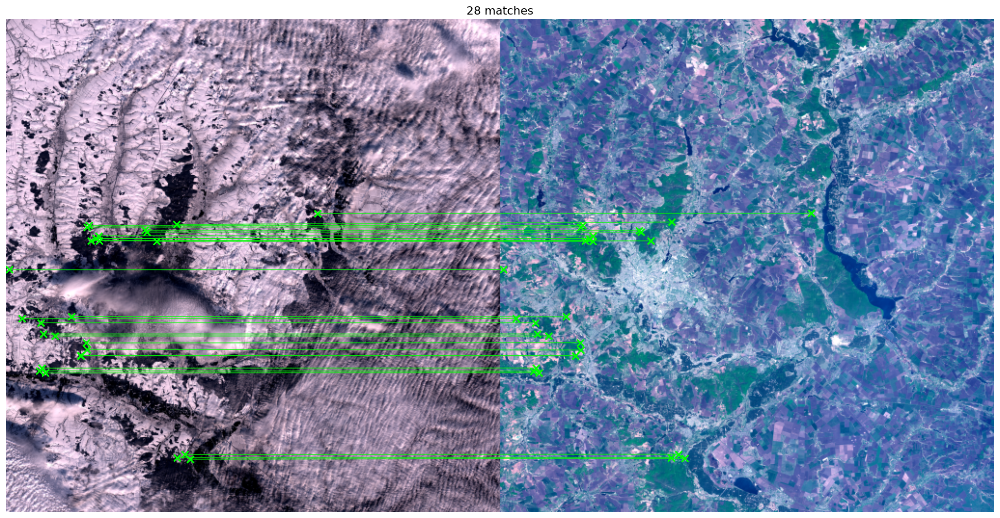


Pair 3: winter vs autumn
Keypoints: 6511, 6730
Matches: 111 raw, 75 inliers


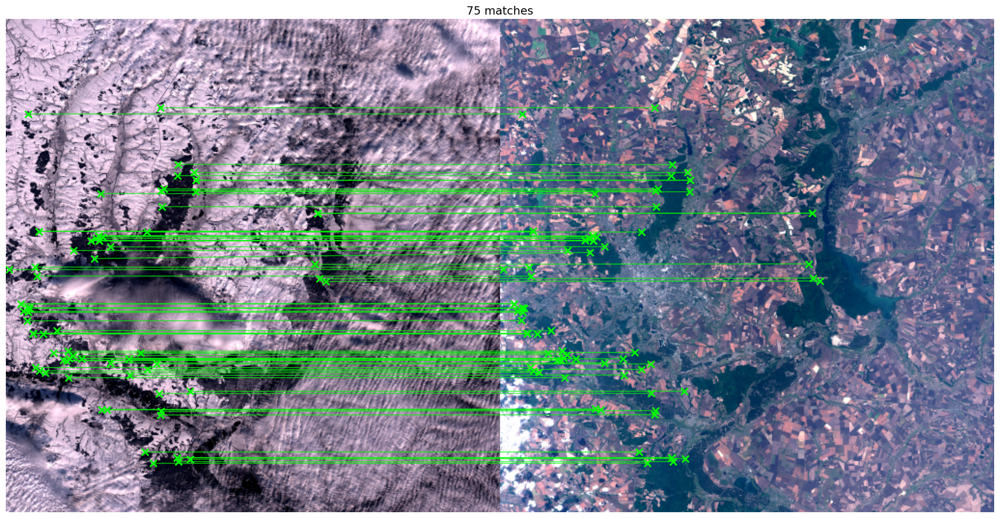


Pair 4: summer vs spring
Keypoints: 6120, 6514
Matches: 175 raw, 147 inliers


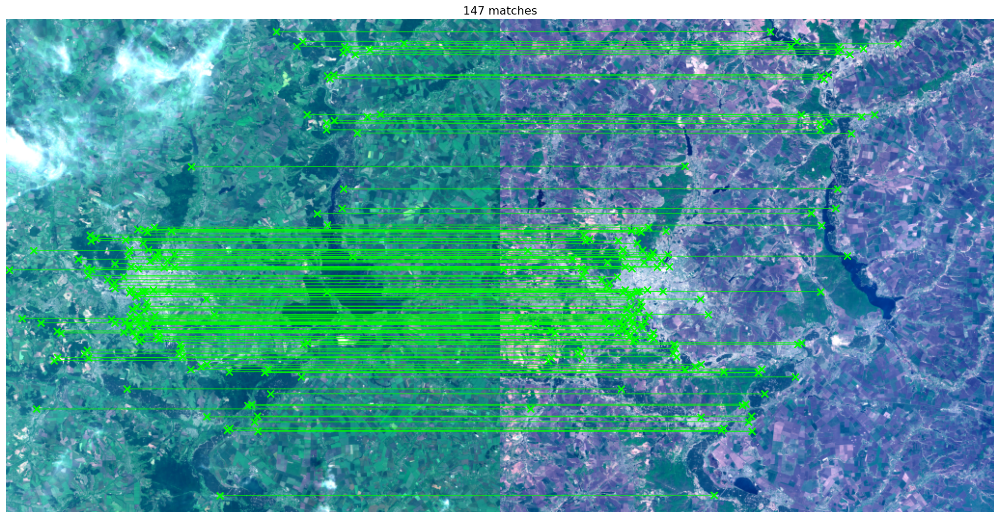


Pair 5: summer vs autumn
Keypoints: 6120, 6730
Matches: 258 raw, 229 inliers


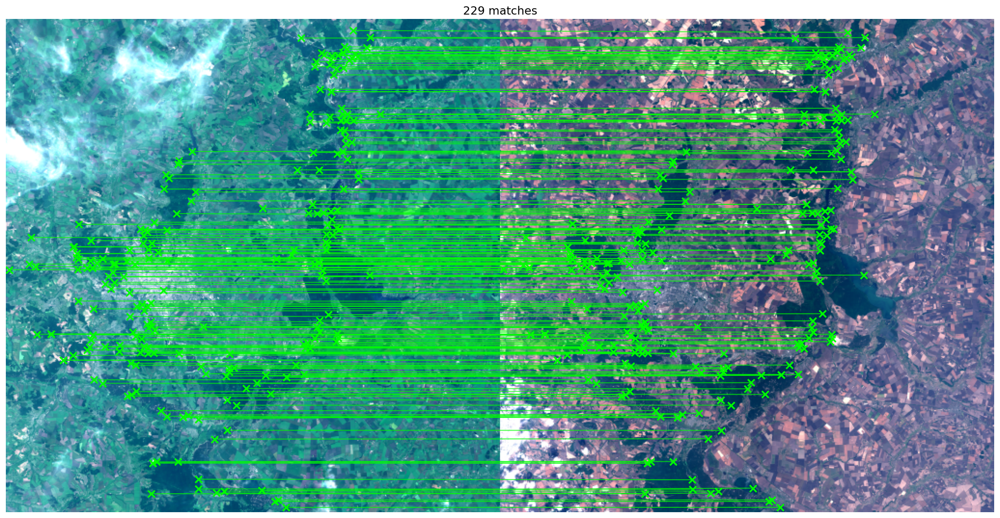


Pair 6: spring vs autumn
Keypoints: 6514, 6730
Matches: 124 raw, 96 inliers


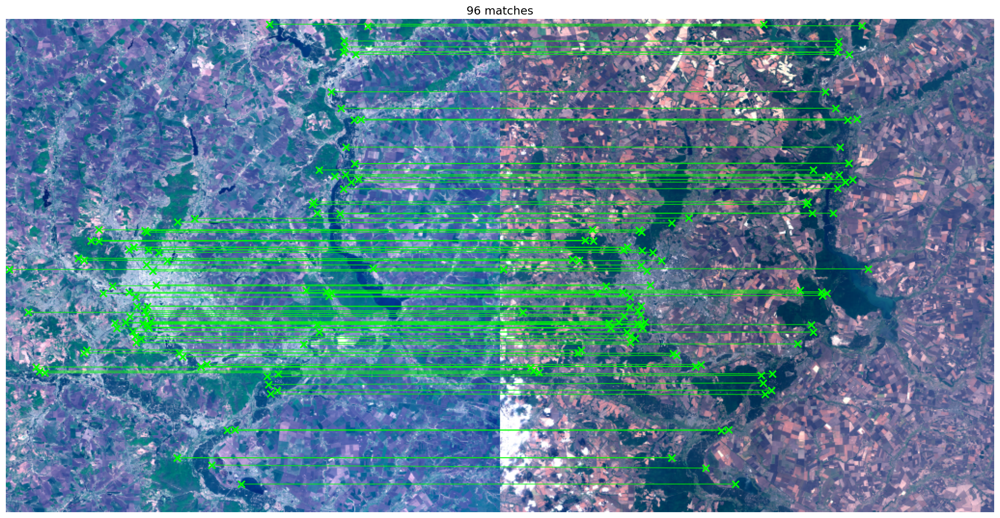

In [11]:
for pair in pairs_info:
    img1, img2 = load_image_pair(str(pair['dir']))
    results = matcher.match_image_pair(img1, img2)
    
    print(f"\nPair {pair['pair_id']}: {pair['season1']} vs {pair['season2']}")
    print(f"Keypoints: {len(results['keypoints1'])}, {len(results['keypoints2'])}")
    print(f"Matches: {results['num_raw_matches']} raw, {results['num_inliers']} inliers")
    
    if results['num_inliers'] > 0:
        visualize_matches(img1, img2, results['inlier_points1'], results['inlier_points2'])
    else:
        print("No matches found")

## Summary Table

In [12]:
# Process all pairs
all_results = []

for pair in pairs_info:
    img1, img2 = load_image_pair(str(pair['dir']))
    results = matcher.match_image_pair(img1, img2)
    
    all_results.append({
        'pair_id': pair['pair_id'],
        'season1': pair['season1'],
        'season2': pair['season2'],
        'keypoints1': len(results['keypoints1']),
        'keypoints2': len(results['keypoints2']),
        'raw_matches': results['num_raw_matches'],
        'inliers': results['num_inliers'],
        'inlier_ratio': results['inlier_ratio']
    })
    
    print(f"Pair {pair['pair_id']}: {results['num_inliers']} matches")

df = pd.DataFrame(all_results)
print("\n" + df.to_string(index=False))

Pair 1: 27 matches
Pair 2: 28 matches
Pair 3: 75 matches
Pair 4: 147 matches
Pair 5: 229 matches
Pair 6: 96 matches

 pair_id season1 season2  keypoints1  keypoints2  raw_matches  inliers  inlier_ratio
       1  winter  summer        6511        6120           59       27      0.457627
       2  winter  spring        6511        6514           65       28      0.430769
       3  winter  autumn        6511        6730          111       75      0.675676
       4  summer  spring        6120        6514          175      147      0.840000
       5  summer  autumn        6120        6730          258      229      0.887597
       6  spring  autumn        6514        6730          124       96      0.774194


## Statistics

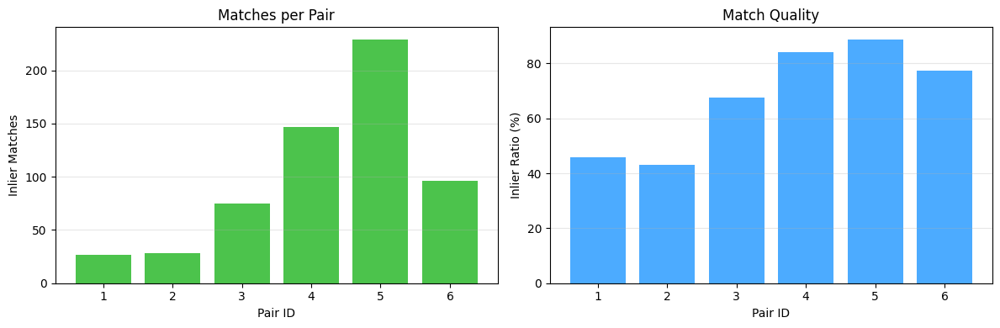


Average keypoints: 6469
Average inliers: 100.3
Average inlier ratio: 67.8%


In [13]:
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

axes[0].bar(df['pair_id'], df['inliers'], color='#00AA00', alpha=0.7)
axes[0].set_xlabel('Pair ID')
axes[0].set_ylabel('Inlier Matches')
axes[0].set_title('Matches per Pair')
axes[0].grid(axis='y', alpha=0.3)

axes[1].bar(df['pair_id'], df['inlier_ratio'] * 100, color='#0088FF', alpha=0.7)
axes[1].set_xlabel('Pair ID')
axes[1].set_ylabel('Inlier Ratio (%)')
axes[1].set_title('Match Quality')
axes[1].grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

print(f"\nAverage keypoints: {(df['keypoints1'].mean() + df['keypoints2'].mean()) / 2:.0f}")
print(f"Average inliers: {df['inliers'].mean():.1f}")
print(f"Average inlier ratio: {df['inlier_ratio'].mean():.1%}")